# Starcraft 2 Online Ranked Matchmaking Rating Analysis and Visualization

### What? Why?

One day a few months ago, someone posed a question regarding Matchmaking Rating (MMR) for the game Starcraft 2 (SC2). I can't remember the exact question anymore but I thought I'd give answering it a go and, well, I kind of ended up going down the rabbit hole a bit.

If you are not familiar with what MMR is, it's a system for rating the skills of players such that players of similar skill levels get matched together. It's a system that's most commonly known about from in chess in the form of the Elo rating system, but has been used elsewhere for similar purposes, most commonly in video games but also in other services that offer matchmaking services like Tinder or Bumble. Matchmaking data tends to follow a normal distribution, which we'll see play out in the data as we examine it.

Anywho, let's get started. We're mostly just going to be looking at descriptive statistics along with visualizing data so we don't need too many fancy libraries; mostly just the basics.

First things first, we need to import pandas, seaborn, and matplotlib. If you've done pretty much anything with data in python you'll likely have tinkered with at least the first and last of these modules. If you are not familiar with seaborn, it's basically matplotlib but fancier and easier to use.

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

Cool. Now that the modules we need are ready to go, we can read in the Starcraft 2 ladder data that has what we want. The data was scraped from the website `rankedftw.com`, which itself gets the data from Blizzard themselves. I could have went straight to Blizzard's API, but I wanted practice with web scraping so I went this route. If you want to test out my web scraper itself, it's included in this repository and there are instructions included on how to use it. A bit of data cleaning is required though to get things working perfectly so I've also included instructions for that.

In [3]:
MMR_data = pd.read_csv("SC2_ladder_data.csv")
MMR_data.shape[0]

421331

Yay. That's done. That number directly above is the total number of rows stored in our DataFrame of SC2 accounts. So that means there are nearly half a million active accounts still in SC2. Not bad for a decade-plus old game. Do keep in mind some people have multiple accounts, but that's not likely to be too many folks these days.


### A Couple Preliminary Bits of Information

Okay, before we go any further, there needs to be a bit of an explanation of what we're going to be looking at. In StarCraft and StarCraft 2 multiplayer, the player can choose from three different races. The races are called Protoss, Terran, and Zerg. The player also can choose to play "Random", which means the game will randomly choose a race for the player. The game is designed such that each race is different mechanically but is created such that they all have roughly an equal chance to win against the other races.

Secondly, we'll be looking at MMR breakdown based on region. In StarCraft 2, there are currently four regions where players are stratified. The two largest are the American region, which is made up of North America and South America, and the European region, which encompasses The UK, all of the EU countries, the eastern European countries, and Russia. The third server is the Chinese server, which contains players from China and various parts of Asia. Finally, the last and smallest region is the Korean region, which despite its diminutive size is regarded as the highest skill-level region. It is mostly populated with people from Korea, Asia, and a small amount of players from the western half of North America.

### Now That That's Over With, Data Time!

When I first started doing this analysis, I initially only looked at the Americas region before expanding out to the other regions. To make what we're looking at easier to understand, I'm going to stick with one region so you can get a feel for what the data looks like. Then later on we can compare the other regions.

First, we will be loooking at each individual race. We'll take a look at the basic information for each before finally comparing them.

First up is Protoss. We'll use pandas' handy dandy query function to filter our data as we would like. Here's what the data currently looks like.

In [4]:
protossAM_data = MMR_data.query('region == "AM" and race == "protoss"')
protossAM_data.head()

,rank,tier,name,mmr,points,wins,losses,played,winrate,age,race,region
0,1,1,Memestermind,6685,934,20,3,23,87.0%,20m,protoss,AM
1,2,1,[N0SCAM]NoWCSForU,6673,668,15,0,15,100.0%,38m,protoss,AM
2,3,1,PartinG,6643,3381,107,19,126,84.9%,2m,protoss,AM
3,4,1,lIlIlIlIlIlI,6635,1056,37,7,44,84.1%,9m,protoss,AM
4,5,1,Hana,6604,1839,229,65,294,77.9%,10m,protoss,AM


In [5]:
protossAM_data.shape[0]

46089

So currently there are about 46000 people on the Americas region's servers playing Protoss. Neat!

Now we'll look at some of the usual basic descriptive statistics to get a feel for how the MMR data looks.

In [6]:
print("Protoss MMR on the Americas server:\nmean: {}\nmedian: {}\nstandard deviation:{}".format(
                                                                                    protossAM_data['mmr'].mean(),
                                                                                    protossAM_data['mmr'].median(),
                                                                                    protossAM_data['mmr'].std()))



Protoss MMR on the Americas server:
mean: 2833.2559612922823
median: 2739.0
standard deviation:700.249565906824


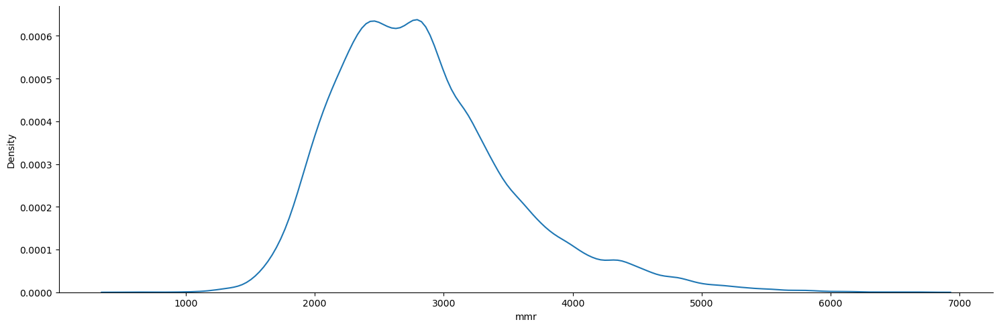

In [9]:
sns.displot(data=protossAM_data, x='mmr', kind='kde', height=5, aspect=3)

In [10]:
zergAM_data = MMR_data.query('region == "AM" and race == "zerg"')
zergAM_data.head()

,rank,tier,name,mmr,points,wins,losses,played,winrate,age,race,region
46089,1,1,[BJWD]MaBaoGuo,6601,1104,50,26,76,65.8%,34m,zerg,AM
46090,2,1,Scarlett,6584,48,2,0,2,100.0%,42m,zerg,AM
46091,3,1,Denver,6348,0,0,1,1,0.0%,31m,zerg,AM
46092,4,1,[PSISTM]Namshar,6317,1848,113,41,154,73.4%,29m,zerg,AM
46093,5,1,[ArGNA]SortOf,6298,48,1,5,6,16.7%,24m,zerg,AM


In [11]:
zergAM_data.shape[0]

40376

In [12]:
zergAM_data['mmr'].median()

2872.0

In [13]:
zergAM_data['mmr'].mean()

2931.5853477313253

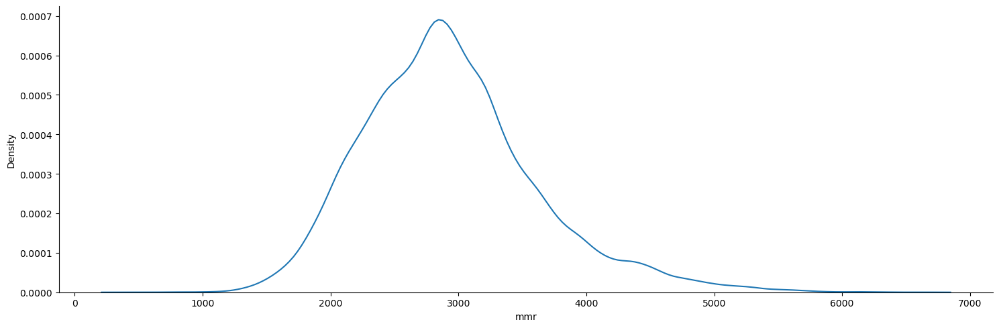

In [14]:
sns.displot(data=zergAM_data, x='mmr', kind='kde', height=5, aspect=3)

In [15]:
terranAM_data = MMR_data.query('region == "AM" and race == "terran"')
terranAM_data.head()

,rank,tier,name,mmr,points,wins,losses,played,winrate,age,race,region
86465,1,1,[Ex0n]SpeCial,6345,1883,72,29,101,71.3%,7m,terran,AM
86466,2,1,Sonagi,6258,0,0,2,2,0.0%,31m,terran,AM
86467,3,1,lllllllllIll,6232,1280,29,6,35,82.9%,26m,terran,AM
86468,4,1,[αX]MaSa,6196,240,6,2,8,75.0%,7m,terran,AM
86469,5,1,Spear,6186,0,0,1,1,0.0%,7m,terran,AM


In [16]:
terranAM_data.shape[0]

50579

In [17]:
terranAM_data['mmr'].median()

2635.0

In [18]:
terranAM_data['mmr'].mean()

2744.95745269776

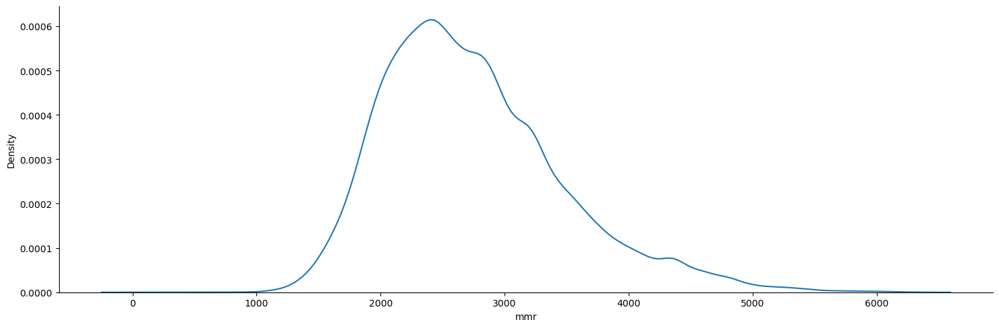

In [19]:
sns.displot(data=terranAM_data, x='mmr', kind='kde', height=5, aspect=3)

In [20]:
randomAM_data = MMR_data.query('region == "AM" and race == "random"')
randomAM_data.head()

,rank,tier,name,mmr,points,wins,losses,played,winrate,age,race,region
137044,1,1,[xGenGx]PiLiPiLi,6054,0,1,1,2,50.0%,28m,random,AM
137045,2,1,[MFSC2]pezzaperry,5911,48,2,1,3,66.7%,7m,random,AM
137046,3,1,[Ex0n]Burninator,5670,0,1,0,1,100.0%,38m,random,AM
137047,4,1,[LRKT]Guitarcheese,5636,0,1,0,1,100.0%,46m,random,AM
137048,5,1,[R1seUP]TheBlazer,5554,48,1,2,3,33.3%,38m,random,AM


In [21]:
randomAM_data.shape[0]

13736

In [22]:
randomAM_data['mmr'].median()

2822.0

In [23]:
randomAM_data['mmr'].mean()

2870.2438846825858

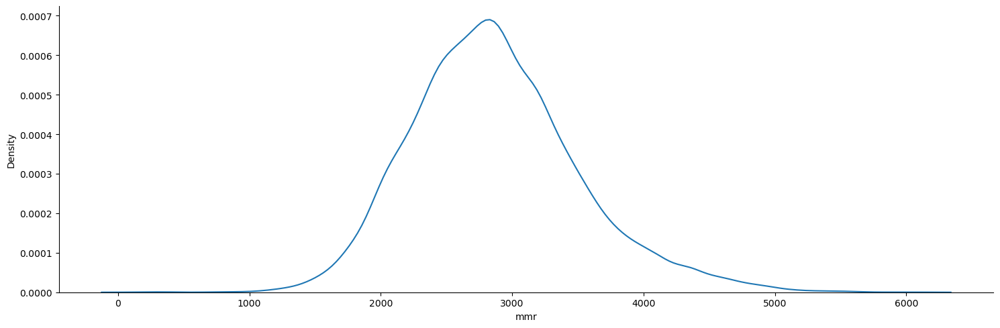

In [24]:
sns.displot(data=randomAM_data, x='mmr', kind='kde', height=5, aspect=3)

In [25]:
combined_AM = pd.concat([protossAM_data, terranAM_data, zergAM_data, randomAM_data])
combined_AM.shape[0]

150780

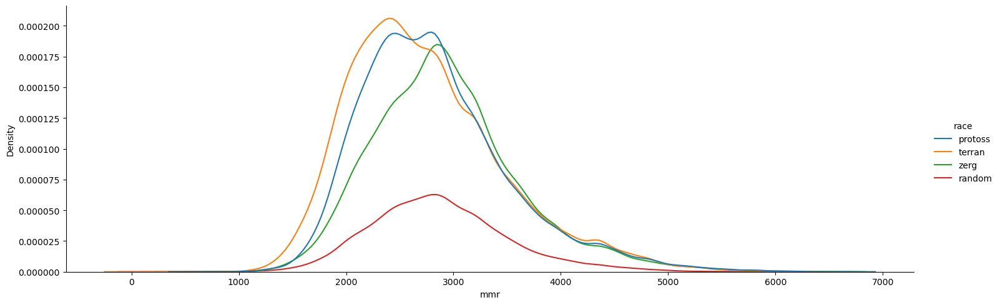

In [26]:
sns.displot(data=combined_AM, x='mmr',  hue='race', kind='kde', height=5, aspect=3)

In [27]:
combined_AM['mmr'].mean()

2833.3366295264623

In [28]:
combined_AM['mmr'].median()

2760.0

In [29]:
combined_AM['mmr'].mode()

0    2765
Name: mmr, dtype: int64

In [30]:
combined_AM['played'].mean()

55.30782597161427

In [31]:
combined_AM.query('played >= 10')

,rank,tier,name,mmr,points,wins,losses,played,winrate,age,race,region
0,1,1,Memestermind,6685,934,20,3,23,87.0%,20m,protoss,AM
1,2,1,[N0SCAM]NoWCSForU,6673,668,15,0,15,100.0%,38m,protoss,AM
2,3,1,PartinG,6643,3381,107,19,126,84.9%,2m,protoss,AM
3,4,1,lIlIlIlIlIlI,6635,1056,37,7,44,84.1%,9m,protoss,AM
4,5,1,Hana,6604,1839,229,65,294,77.9%,10m,protoss,AM
...,...,...,...,...,...,...,...,...,...,...,...,...
150772,13729,3,[AntRuS]Raistlin,905,90,3,8,11,27.3%,1h,random,AM
150773,13730,2,Quadena,896,78,2,20,22,9.1%,1h,random,AM
150776,13733,2,[WuTang]BingGan,394,1065,3142,4631,7773,40.4%,1h,random,AM
150777,13734,3,llllllllllll,349,0,742,2992,3734,19.9%,58m,random,AM


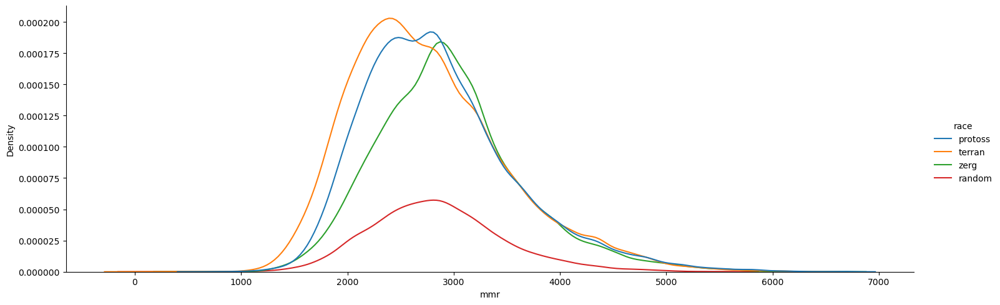

In [32]:
sns.displot(data=combined_AM.query('played >= 10'), x='mmr',  hue='race', kind='kde', height=5, aspect=3)

In [33]:
combined_AM.query('played >= 10')['mmr'].mean()

2850.84547507625

In [34]:
combined_AM.query('played >= 10')['mmr'].median()

2778.0

In [35]:
print('mean:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossAM_data.query('played >= 10')['mmr'].mean(), 
    terranAM_data.query('played >= 10')['mmr'].mean(),
    zergAM_data.query('played >= 10')['mmr'].mean(),
    randomAM_data.query('played >= 10')['mmr'].mean()))

mean:
protoss:2862.6679554070793
terran: 2759.2762558629597
zerg: 2958.1387587304393
random:2844.194263544409


In [36]:
print('median:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossAM_data.query('played >= 10')['mmr'].median(), 
    terranAM_data.query('played >= 10')['mmr'].median(),
    zergAM_data.query('played >= 10')['mmr'].median(),
    randomAM_data.query('played >= 10')['mmr'].median()))

median:
protoss:2769.0
terran: 2650.5
zerg: 2899.0
random:2803.0


In [37]:
print('protoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossAM_data.query('played >= 10')['mmr'].shape[0], 
    terranAM_data.query('played >= 10')['mmr'].shape[0],
    zergAM_data.query('played >= 10')['mmr'].shape[0],
    randomAM_data.query('played >= 10')['mmr'].shape[0]))

protoss:26641
terran: 29422
zerg: 22622
random:7217


In [38]:
combined_AM.query('played >= 10')['played'].mean()

93.99606528369537

In [39]:
print('protoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossAM_data.query('played >= 10')['mmr'].shape[0]/protossAM_data['mmr'].shape[0], 
    terranAM_data.query('played >= 10')['mmr'].shape[0]/terranAM_data['mmr'].shape[0],
    zergAM_data.query('played >= 10')['mmr'].shape[0]/zergAM_data['mmr'].shape[0],
    randomAM_data.query('played >= 10')['mmr'].shape[0]/randomAM_data['mmr'].shape[0]))

protoss:0.5780338041615136
terran: 0.581703869194725
zerg: 0.5602833366356251
random:0.5254076878276063


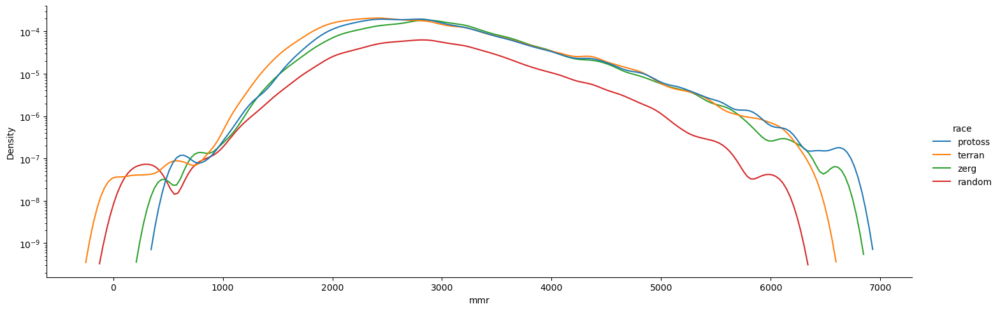

In [40]:
sns.displot(data=combined_AM, x='mmr',  hue='race', kind='kde', height=5, aspect=3).set( yscale='log')


[None, (10, 3500)]

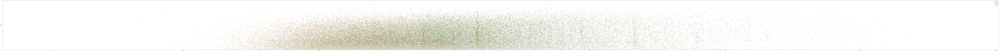

In [41]:
plt.figure(figsize=(300,15))
sns.scatterplot(data=combined_AM.query('played >= 10'), x='mmr', y='played', hue='race', alpha=0.6).set(yscale='log', ylim=(10,3500))

[None, (100.0, 3500)]

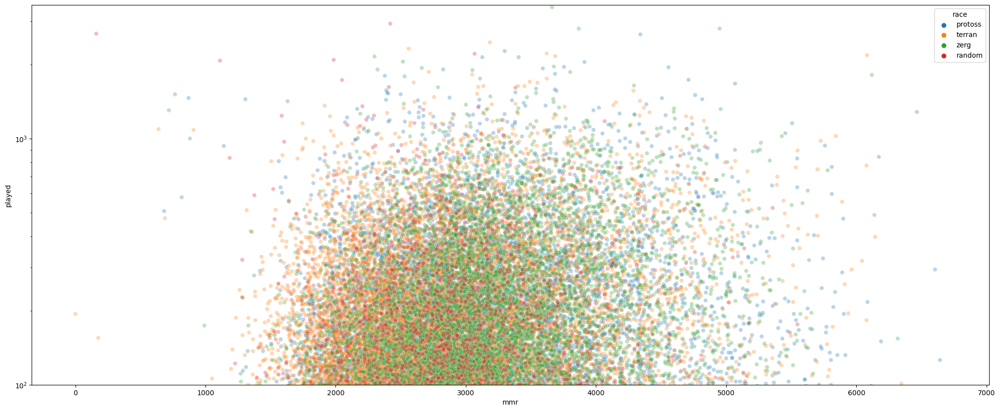

In [42]:
plt.figure(figsize=(25,10))
sns.scatterplot(data=combined_AM.query('played >= 10'), x='mmr', y='played', hue='race', alpha=0.3).set(yscale='log', ylim=(10e1,3500))

In [43]:
len(set(combined_AM.query('played >= 10')['name']))

58921

## The Other Servers

Since there are three more servers to examine, we won't be going through them with the same level of granularity as we did with the North American server. First we'll just read in all the data and look at the basic info for each.

In [44]:
protossEU_data = MMR_data.query('region == "EU" and race == "protoss"')
zergEU_data = MMR_data.query('region == "EU" and race == "zerg"')
terranEU_data = MMR_data.query('region == "EU" and race == "terran"')
randomEU_data = MMR_data.query('region == "EU" and race == "random"')

combined_EU = pd.concat([protossEU_data, terranEU_data, zergEU_data, randomEU_data])
print('Total number of players: {}\nTotal Protoss: {}\nTotal Terran: {}\nTotal Zerg: {}\nTotal Random: {}'.format(combined_EU.shape[0], 
                                                                                                protossEU_data.shape[0],
                                                                                                zergEU_data.shape[0],
                                                                                                terranEU_data.shape[0],
                                                                                                randomEU_data.shape[0]))

Total number of players: 154243
Total Protoss: 47751
Total Terran: 41326
Total Zerg: 51938
Total Random: 13228


In [45]:
print('mean MMR:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossEU_data['mmr'].mean(), 
    terranEU_data['mmr'].mean(),
    zergEU_data['mmr'].mean(),
    randomEU_data['mmr'].mean()))

mean MMR:
protoss:2873.401771690645
terran: 2780.4738149331897
zerg: 2976.576828146929
random:2923.5136074992442


In [46]:
print('median MMR:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossEU_data['mmr'].median(), 
    terranEU_data['mmr'].median(),
    zergEU_data['mmr'].median(),
    randomEU_data['mmr'].median()))

median MMR:
protoss:2767.0
terran: 2665.0
zerg: 2912.0
random:2868.0


In [47]:
protossKR_data = MMR_data.query('region == "KR" and race == "protoss"')
zergKR_data = MMR_data.query('region == "KR" and race == "zerg"')
terranKR_data = MMR_data.query('region == "KR" and race == "terran"')
randomKR_data = MMR_data.query('region == "KR" and race == "random"')

combined_KR = pd.concat([protossKR_data, terranKR_data, zergKR_data, randomKR_data])
print('Total number of players: {}\nTotal Protoss: {}\nTotal Terran: {}\nTotal Zerg: {}\nTotal Random: {}'.format(combined_KR.shape[0], 
                                                                                                protossKR_data.shape[0],
                                                                                                zergKR_data.shape[0],
                                                                                                terranKR_data.shape[0],
                                                                                                randomKR_data.shape[0]))

Total number of players: 33284
Total Protoss: 9916
Total Terran: 8341
Total Zerg: 12253
Total Random: 2774


In [48]:
print('mean MMR:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossKR_data['mmr'].mean(), 
    terranKR_data['mmr'].mean(),
    zergKR_data['mmr'].mean(),
    randomKR_data['mmr'].mean()))

mean MMR:
protoss:3135.0100847115773
terran: 3132.793846404962
zerg: 3197.605562882148
random:3133.057678442682


In [49]:
print('median MMR:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossKR_data['mmr'].median(), 
    terranKR_data['mmr'].median(),
    zergKR_data['mmr'].median(),
    randomKR_data['mmr'].median()))

median MMR:
protoss:2983.0
terran: 3024.0
zerg: 3083.0
random:3057.0


In [48]:
protossCN_data = MMR_data.query('region == "CN" and race == "protoss"')
zergCN_data = MMR_data.query('region == "CN" and race == "zerg"')
terranCN_data = MMR_data.query('region == "CN" and race == "terran"')
randomCN_data = MMR_data.query('region == "CN" and race == "random"')
combined_CN = pd.concat([protossCN_data, terranCN_data, zergCN_data, randomCN_data])
print('Total number of players: {}\nTotal Protoss: {}\nTotal Terran: {}\nTotal Zerg: {}\nTotal Random: {}'.format(combined_CN.shape[0], 
                                                                                                protossCN_data.shape[0],
                                                                                                zergCN_data.shape[0],
                                                                                                terranCN_data.shape[0],
                                                                                                randomCN_data.shape[0]))

Total number of players: 83024
Total Protoss: 26502
Total Terran: 21025
Total Zerg: 29369
Total Random: 6128


In [49]:
print('mean MMR:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossCN_data['mmr'].mean(), 
    terranCN_data['mmr'].mean(),
    zergCN_data['mmr'].mean(),
    randomCN_data['mmr'].mean()))

mean MMR:
protoss:2849.4832842804317
terran: 2810.524396472471
zerg: 2922.0080856123664
random:2925.101174934726


In [50]:
print('median MMR:\nprotoss:{}\nterran: {}\nzerg: {}\nrandom:{}'.format(
    protossCN_data['mmr'].median(), 
    terranCN_data['mmr'].median(),
    zergCN_data['mmr'].median(),
    randomCN_data['mmr'].median()))

median MMR:
protoss:2741.0
terran: 2717.0
zerg: 2855.0
random:2876.0


[None, (10, 3500)]

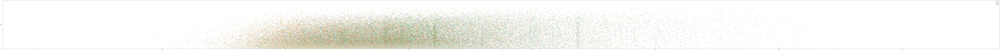

In [51]:
plt.figure(figsize=(300,15))
sns.scatterplot(data=combined_EU, x='mmr', y='played', hue='race', alpha=0.6).set(yscale='log', ylim=(10,3500))

[None, (10, 3500)]

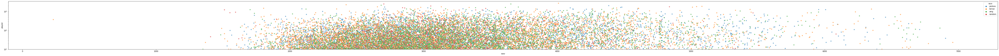

In [52]:
plt.figure(figsize=(100,5))
sns.scatterplot(data=combined_KR, x='mmr', y='played', hue='race', alpha=0.6).set(yscale='log', ylim=(10,3500))

[None, (10, 3500)]

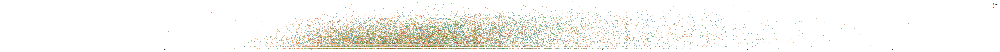

In [53]:
plt.figure(figsize=(200,10))
sns.scatterplot(data=combined_CN, x='mmr', y='played', hue='race', alpha=0.6).set(yscale='log', ylim=(10,3500))

# I ran into a weird issue that required me to manually fix the data for the Chinese server before this would work.
# Essentially, 8 or so rows of data ended up with no name, and thus were missing a column, causing the win/loss
# percentage to show up as the number of games played. My suspicion is it's probably an encoding problem where
# the scraper was reading in one encoding standard, and the characters used were in another, causing it to read
# nothing. Anyhow, I created broken.py, which can find the broken rows, then you just have to manually chuck in
# a name and delete the extra comma near the end of each row and it'll fix everything. I'll probably automate 
#fixing this for next time.

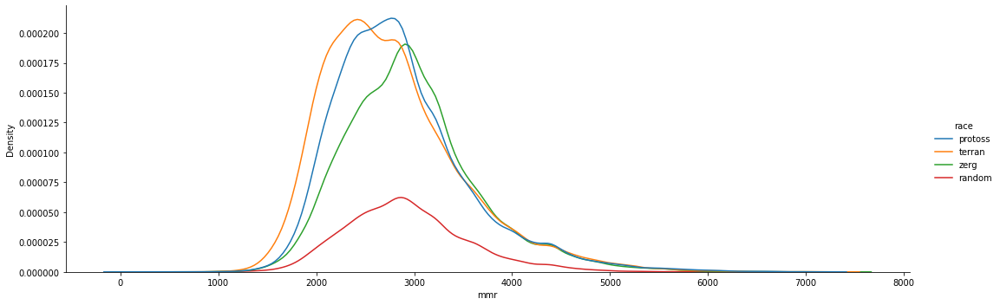

In [54]:
sns.displot(data=combined_EU, x='mmr',  hue='race', kind='kde', height=5, aspect=3)

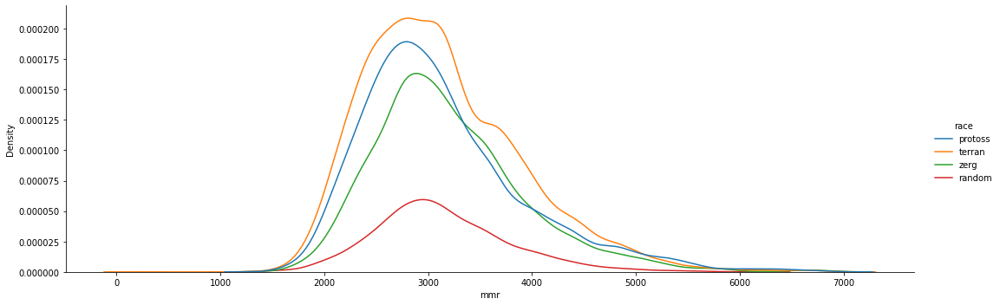

In [55]:
sns.displot(data=combined_KR, x='mmr',  hue='race', kind='kde', height=5, aspect=3)

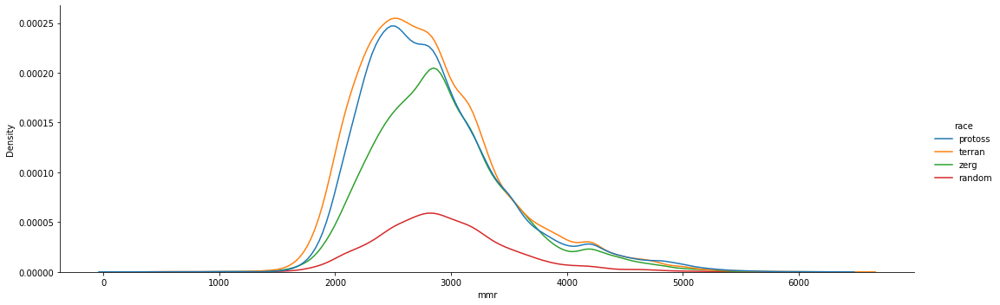

In [56]:
sns.displot(data=combined_CN, x='mmr',  hue='race', kind='kde', height=5, aspect=3)

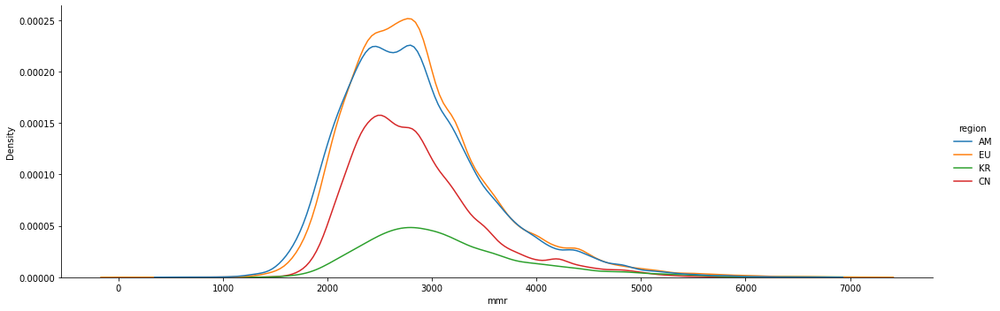

In [57]:
all_protoss = MMR_data.query('race == "protoss"')
sns.displot(data=all_protoss, x='mmr',  hue='region', kind='kde', height=5, aspect=3)

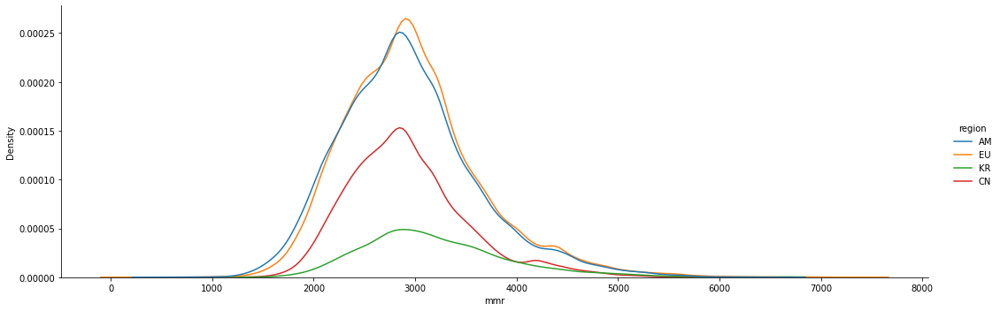

In [58]:
all_zerg = MMR_data.query('race == "zerg"')
sns.displot(data=all_zerg, x='mmr',  hue='region', kind='kde', height=5, aspect=3)

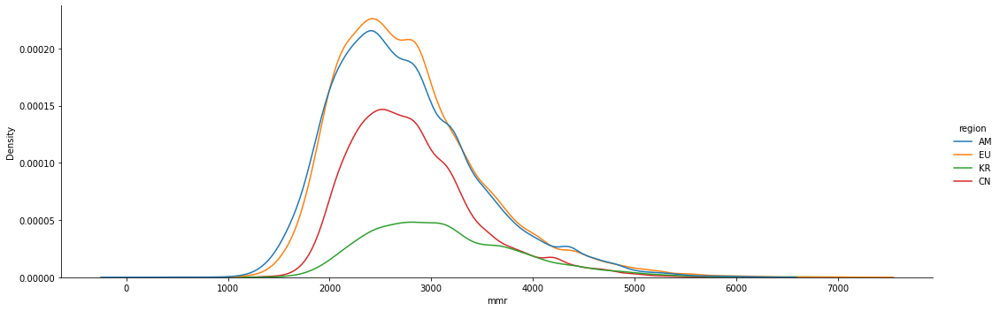

In [59]:
all_terran = MMR_data.query('race == "terran"')
sns.displot(data=all_terran, x='mmr',  hue='region', kind='kde', height=5, aspect=3)

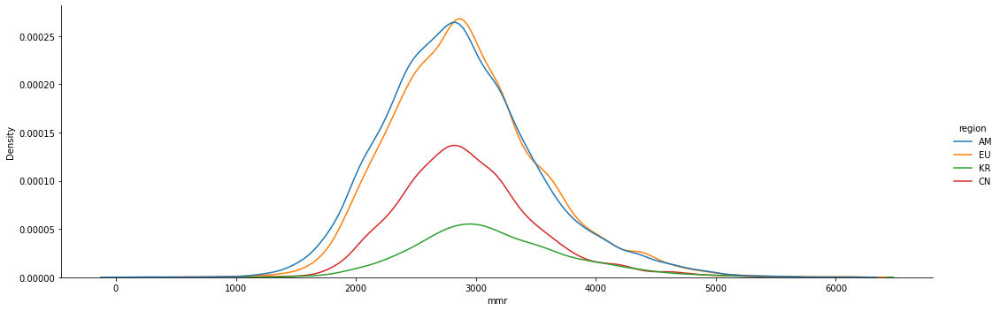

In [60]:
all_random = MMR_data.query('race == "random"')
sns.displot(data=all_random, x='mmr',  hue='region', kind='kde', height=5, aspect=3)

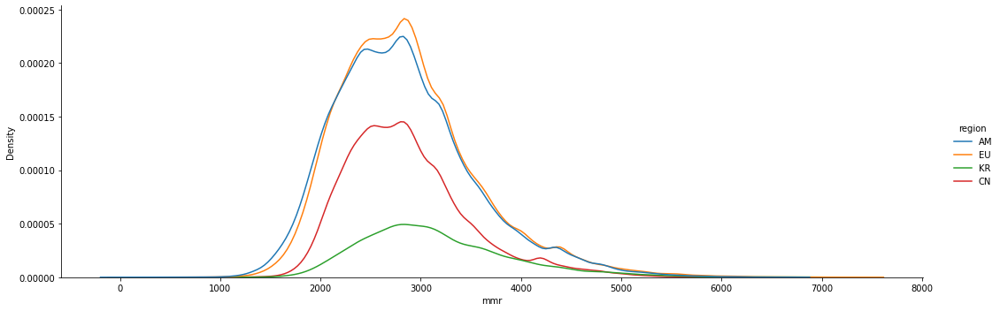

In [61]:

sns.displot(data=MMR_data, x='mmr',  hue='region', kind='kde', height=5, aspect=3)

[None, (10, 3500)]

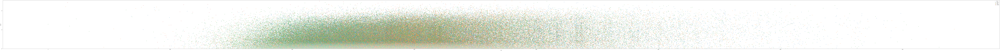

In [62]:
plt.figure(figsize=(300,15))
sns.scatterplot(data=MMR_data, x='mmr', y='played', hue='race', alpha=0.6).set(yscale='log', ylim=(10,3500))